
### Color Mapping 


**Goals:**
* Learn various image processing operations.
* Perform image operations such as Smoothing,Blurring, Morphological Operations. 
* Grab properties such as color spaces and histograms.


### Colorspaces 


* So far we've only worked with RGB color spaces, in RGB coding, colors are modeled as a combination of Red, Green, and Blue.
* In the 1970s HSL (hue,saturation,lightness) and HSV (hue,saturation,value) were developed as alternative color models.

* HSL and HSV are more closely aligned with the war human vision actually perceives color

#### RGB Model Representation of Colors: 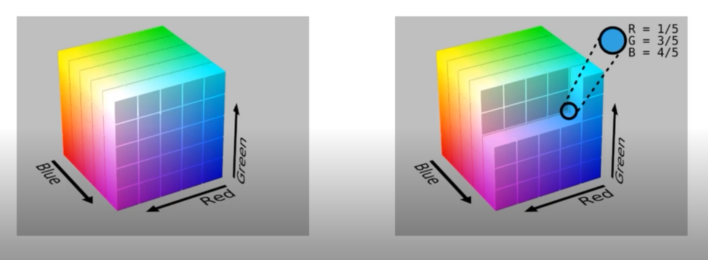

#### HSL Cylinder Model: 
we visualize HSL model as a cylinder model.
HSL : Hue,Saturation and Lightness

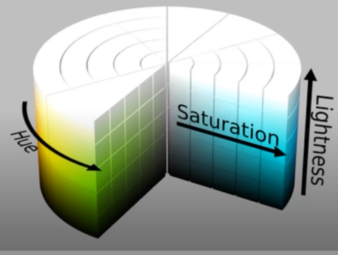

**Hue:**
The hue is the color type (such as red, blue, or yellow) shown on the cylinder model. It ranges from 0-360 (but normalized to 0-100% in some applications).

**Saturation (S)**
The saturation is the purity or intensity of a color.

The saturation is sometimes called the "vibrancy" of the color and is shown in vertical direction of the center triangle of the color wheel. It ranges from 0-100%.

**Brightness (B or V)**
Brightness or value of a color is an attribute of visual perception in which a light source appears to emit a given amount of light. Brightness is also known as luminance in another context.

It ranges from 0-100%.

* At the top of the cylinder we have pure white.
* At the buttom of the cylinder we have pure black.

#### HSV Cylinder Model:

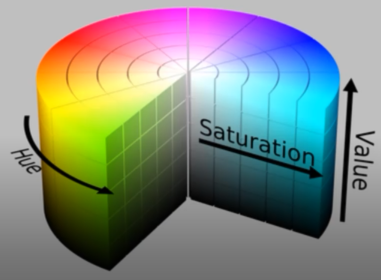

**Hue**
Hue is the color portion of the model, expressed as a number from 0 to 360 degrees:

* Red falls between 0 and 60 degrees.
* Yellow falls between 61 and 120 degrees.
* Green falls between 121 and 180 degrees.
* Cyan falls between 181 and 240 degrees.
* Blue falls between 241 and 300 degrees.
* Magenta falls between 301 and 360 degrees.

**Saturation**
Saturation describes the amount of gray in a particular color, from 0 to 100 percent. Reducing this component toward zero introduces more gray and produces a faded effect. Sometimes, saturation appears as a range from 0 to 1, where 0 is gray, and 1 is a primary color.

**Value (or Brightness)**
Value works in conjunction with saturation and describes the brightness or intensity of the color, from 0 to 100 percent, where 0 is completely black, and 100 is the brightest and reveals the most color.

#### Converting colorspace:
For converting colorspace we use **cvtColor** function.

In [ ]:
import cv2
import matplotlib.pyplot as plt 
%matplotlib inline

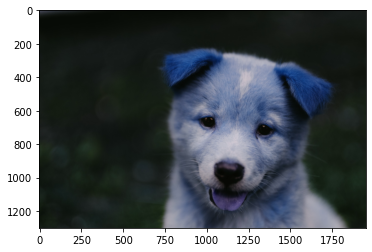

In [ ]:
img = cv2.imread('/content/puppy.jpg')
plt.imshow(img);

Converting Blue, Green, Red (BGR) to Red,Green,Blue (RGB) channel to obtain the origional image.

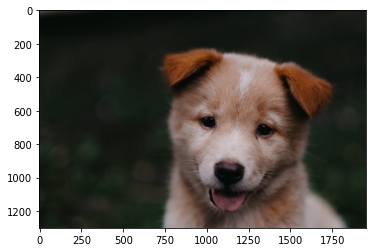

In [ ]:
img_rgb = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
plt.imshow(img_rgb);

#### Converting to HSV Colorspace:

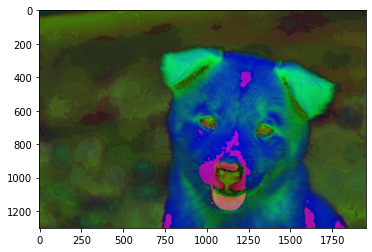

In [ ]:
img_hsv = cv2.cvtColor(img_rgb,cv2.COLOR_RGB2HSV)
plt.imshow(img_hsv);

#### Converting to HSL Colorspace: 

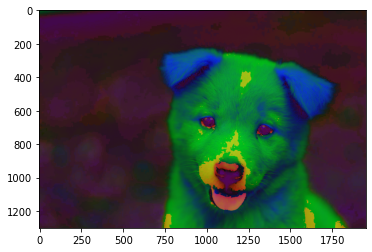

In [ ]:
img_hsl = cv2.cvtColor(img_rgb,cv2.COLOR_RGB2HLS)
plt.imshow(img_hsl);

### Blending and Pasting Image:


Here we will be working with multiple images.
OpenCV has many programmatic methods of blending image together and pasting images on top of each other.

* Blending images is done through the **addWeighted** function that uses both images and combines them.
* To blend images we use a simple formula: 

\begin{align*}
new-pixel = α * pixel_1 + β * pixel_2 + γ
\end{align*}

In [ ]:
import cv2
import matplotlib.pyplot as plt
%matplotlib inline

##### Loading two images:

In [ ]:
img1 = cv2.imread('/content/dog_backpack.jpg')
img1_rgb = cv2.cvtColor(img1,cv2.COLOR_BGR2RGB)
img2 = cv2.imread('/content/watermark_no_copy.png')
img2_rgb = cv2.cvtColor(img2,cv2.COLOR_BGR2RGB)

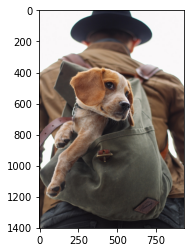

In [ ]:
plt.imshow(img1_rgb);

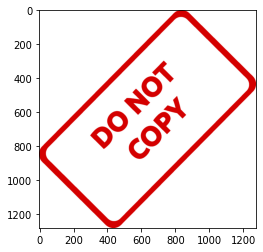

In [ ]:
plt.imshow(img2_rgb);

#### Blending Image of Same size : 
**addWeighted()** work with the image of same sizes.

For this checking the size of both images. 

In [ ]:
img1.shape

(1401, 934, 3)

In [ ]:
img2.shape

(1280, 1277, 3)

Resizing image, so that they are equal to each other for blending.

In [ ]:
img1 = cv2.resize(img1_rgb,(1200,1200))
img2 = cv2.resize(img2_rgb,(1200,1200))

Diplaying the image after resizing.

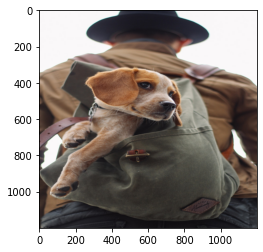

In [ ]:
plt.imshow(img1);

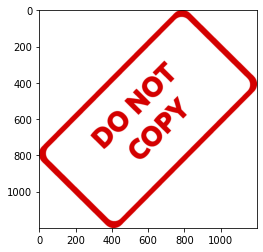

In [ ]:
plt.imshow(img2);

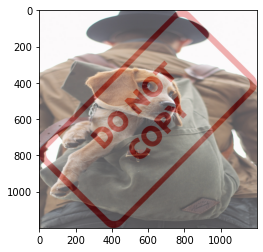

In [ ]:
blended = cv2.addWeighted(src1 = img1, alpha = 0.7, src2 = img2, beta = 0.3, gamma = 0)
plt.imshow(blended);

#### Overlay Image of different sizes: 

**TASK 1:** Overlay Small Image on the top of a Large Image (No blending)
All this is actually going to be a Numpy reassignment operation.



In [ ]:
# Loading images
img1 = cv2.imread('/content/dog_backpack.jpg')
img1_rgb = cv2.cvtColor(img1,cv2.COLOR_BGR2RGB)
img2 = cv2.imread('/content/watermark_no_copy.png')
img2_rgb = cv2.cvtColor(img2,cv2.COLOR_BGR2RGB)

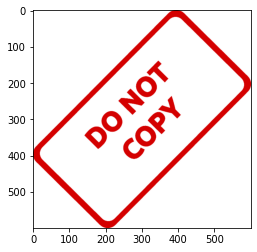

In [ ]:
img2 = cv2.resize(img2_rgb,(600,600))
plt.imshow(img2);

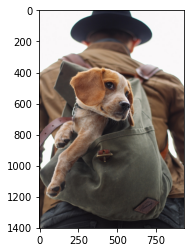

In [ ]:
plt.imshow(img1_rgb);

level imge for keeping track:



In [ ]:
large_img = img1_rgb
small_img = img2

Taking the chunk of the large image pixel value and repacing with the entirity of the small image. We use numpy slicing for this.

In [ ]:
x_offset = 0
y_offset = 0

Offset set the markers of where you actually start the image and where you actually going to overlay the image. In this case we start at the top left corner.

In [ ]:
x_end = x_offset + small_img.shape[1]
y_end = y_offset + small_img.shape[0]

Then we have to figure out where we are gooing to end. Here end point is our offset plus height of the image.

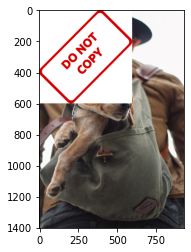

In [ ]:
large_img[y_offset:y_end, x_offset:x_end] = small_img
plt.imshow(large_img);



**TASK2:** Blending together image of different sizes.



Masking the certain part of image and blending.

In [ ]:
# Loading images
img1 = cv2.imread('/content/dog_backpack.jpg')
img1 = cv2.cvtColor(img1,cv2.COLOR_BGR2RGB)
img2 = cv2.imread('/content/watermark_no_copy.png')
img2_rgb = cv2.cvtColor(img2,cv2.COLOR_BGR2RGB)

In [ ]:
img2 = cv2.resize(img2_rgb,(600,600))

**Creating ROI (Reason of Interest):** Where on the actual image do you want to blend in. Here you have to figure out where 600x600 on the dog_backpack image is blended with *Do Not Copy* Image.

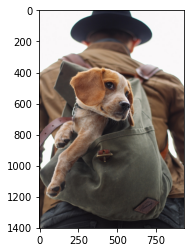

In [ ]:
plt.imshow(img1);

In [ ]:
img1.shape

(1401, 934, 3)

Defining offset for Top Left corner and Buttom right corner.

In [ ]:
# Buttom right corner.
x_offset = 934-600
y_offset = 1401-600

Creating ROI of the same size of the forground image (i.e. small image).

In [ ]:
img2.shape

(600, 600, 3)

We use tuple unpacking to reasign the shape.

In [ ]:
rows,cols,channels = img2.shape
print(rows)
print(cols)
print(channels)

600
600
3


Now we should grab the ROI using slicing.

In [ ]:
roi = img1[y_offset:1401,x_offset:934]

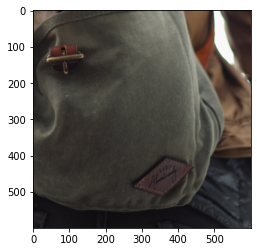

In [ ]:
plt.imshow(roi);

On plotting ROI, we get the buttom right corner of the image.

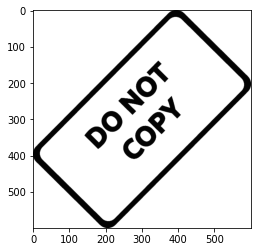

In [ ]:
img2_gray = cv2.cvtColor(img2,cv2.COLOR_RGB2GRAY)
plt.imshow(img2_gray,cmap='gray');

Calculating inverse of this image using bitwise not operator. Here, every thing that the black is white and white is black.

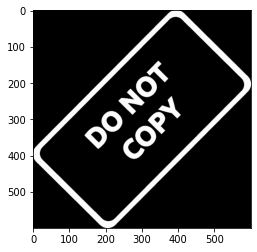

In [ ]:
mask_inv = cv2.bitwise_not(img2_gray)
plt.imshow(mask_inv, cmap = 'gray');

If we check the shape of the mask_inv, it no longer contain the color channel.

In [ ]:
mask_inv.shape

(600, 600)

The way we gonna fix this by using NumPy.

In [ ]:
import numpy as np
white_background = np.full(img2.shape,255,dtype = np.uint8)

In [ ]:
white_background.shape

(600, 600, 3)

In [ ]:
bk = cv2.bitwise_or(white_background, white_background,mask=mask_inv)

Here we grab white background and put that mask on the top of it.

In [ ]:
bk.shape

(600, 600, 3)

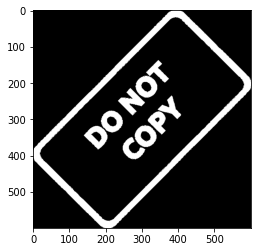

In [ ]:
plt.imshow(bk);

Now we are going to to grab the origional forground image and place it on the top of the mask.

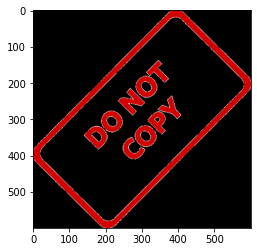

In [ ]:
fg = cv2.bitwise_or(img2,img2, mask = mask_inv)
plt.imshow(fg);

This is how the mask is working.  Now it's the time to calculate the reason of interest(ROI) and then blending the mask with a ROI.

In [ ]:
final_roi = cv2.bitwise_or(roi,fg)

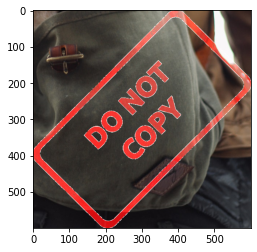

In [ ]:
plt.imshow(final_roi);

Now we overlay large image and small image's ROI to obtain the final blended image.

In [ ]:
large_img_final = img1
small_img_final = final_roi 

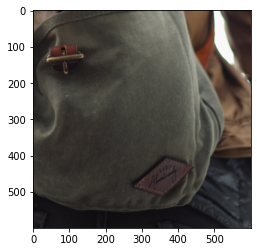

In [ ]:
blended_img_final = large_img_final[y_offset:y_offset + small_img_final.shape[0], x_offset:x_offset+small_img_final.shape[1]]
plt.imshow(blended_img_final);

### Image Thresholding: 

* In some CV applications it is often necessary to convert color image to grayscale, since only edges and shapes end up being important.
* Similarly, some applications only require a binary image showing general shapes.

**Defination:** Thresholding is fundamentally a very simple method of segmenting an image into different parts.

* Thresholding will convert an image to consist of only two values, white or black.

#### Converting a color image to binary:


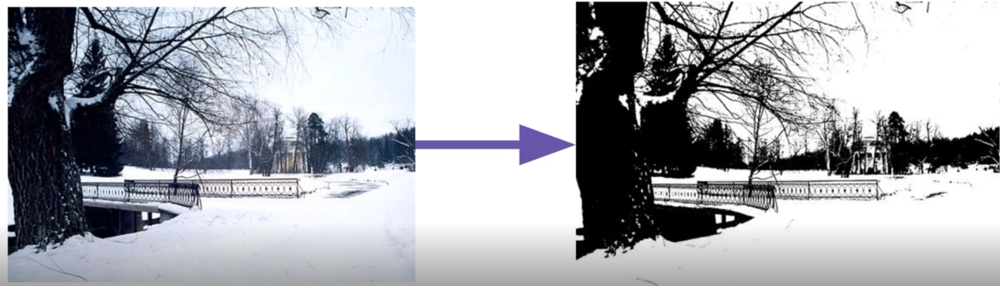

Here on a left we have color image and convert it into grayscale. Then we apply image threshold, which convert grayscale image into a binary image. Where values are black or white.

So, let's explore the syntax and options for thresolding with OpenCV.

In [ ]:
import cv2 
import matplotlib.pyplot as plt 
%matplotlib inline

In [ ]:
img = cv2.imread('/content/rainbow.jpg',0) # Reading image as grayscale.

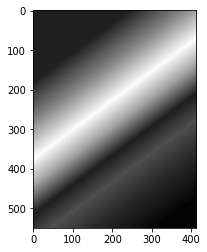

In [ ]:
plt.imshow(img, cmap = 'gray');

Now check the different threshold types.
**parameters: cv2.threshold(source_img, threshold_value, maximum_value, typeof _threshold)**
* THRESH_BINARY
* THREH_BINARY_INV
* THRESH_TRUNC
* THRESH_TOZERO
* THRESH_TOZERO_INV
* THRESH_MASK
* THRESH_OTSU : flag, use OTSU algorthm to choose the threshold value
* THRESH_TRIANGLE : flag, use triangle method to choose the threshold value.

#### Threshold Binary: 

In [ ]:
ret, thresh1 = cv2.threshold(img,127,255,cv2.THRESH_BINARY)

Here any value below 127 that is shifted down to 0 and any value greater than 127 is shifted to 255.

By checking the ret object to see what is the cutoff value is .

In [ ]:
ret

127.0

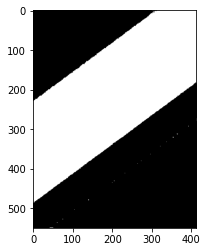

In [ ]:
plt.imshow(thresh1,cmap = 'gray');

Now taking binary inverse of the image.

In [ ]:
ret,thresh2 = cv2.threshold(img,127,255,cv2.THRESH_BINARY_INV)
ret

127.0

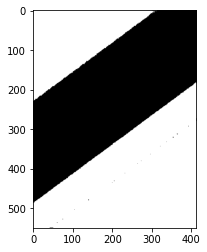

In [ ]:
plt.imshow(thresh2,cmap='gray');

Lets see some example:


In [ ]:
crossword= cv2.imread('/content/crossword.jpg',0)

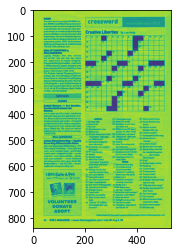

In [ ]:
plt.imshow(crossword);

It's large image but it's showing small here. so create a function to display image.

In [ ]:
def show_pic (crossword):
  fig = plt.figure(figsize=(15,15))
  ax = fig.add_subplot(111)
  ax.imshow(crossword,cmap= 'gray')

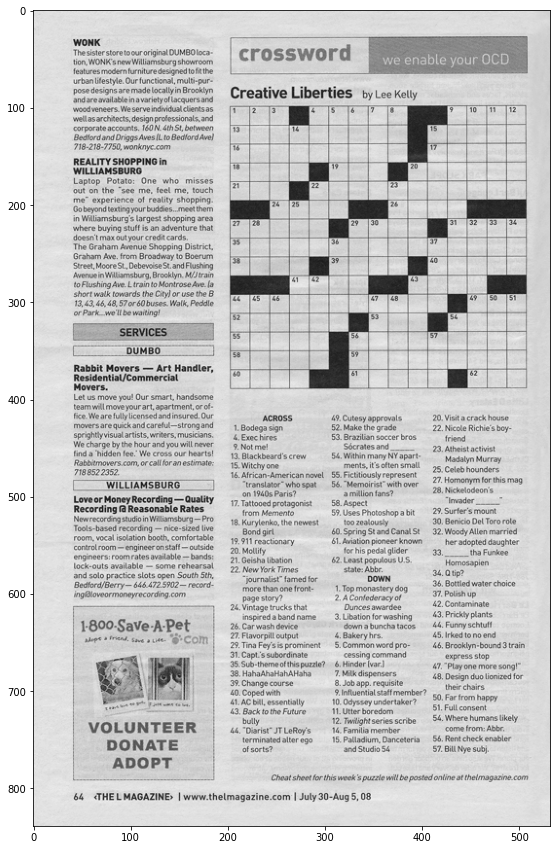

In [ ]:
show_pic(crossword)

We can simply use a binary threshold and play around this.

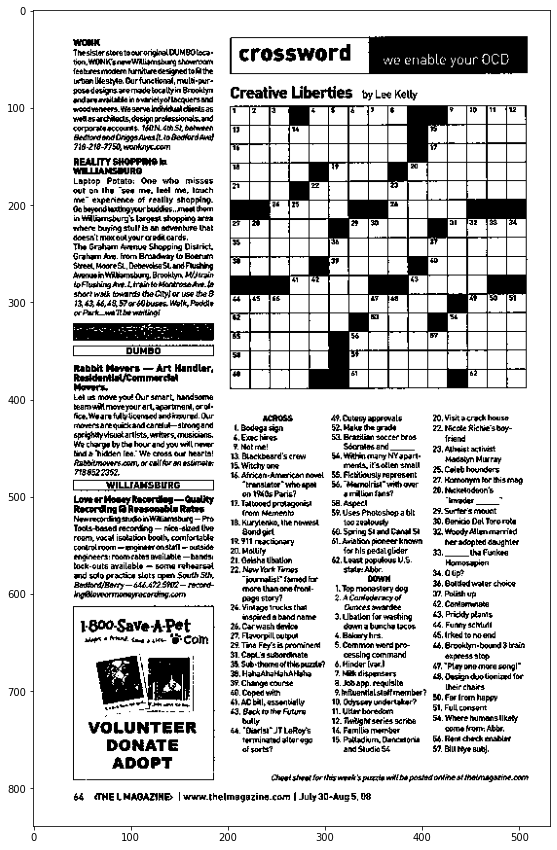

In [ ]:
ret, th1 = cv2.threshold(crossword,180,255,cv2.THRESH_BINARY)
show_pic(th1)

Another method to do it is adaptive threshold. Adaptive threshold method automatically adopt its threshold.

**Syntax:** cv2.adativeThreshold(source_img, max_value, Adaptive Method, Threshold_Type, blocksize, Constant) 

Constant: Constant subtracted from the mean or weighted mean.

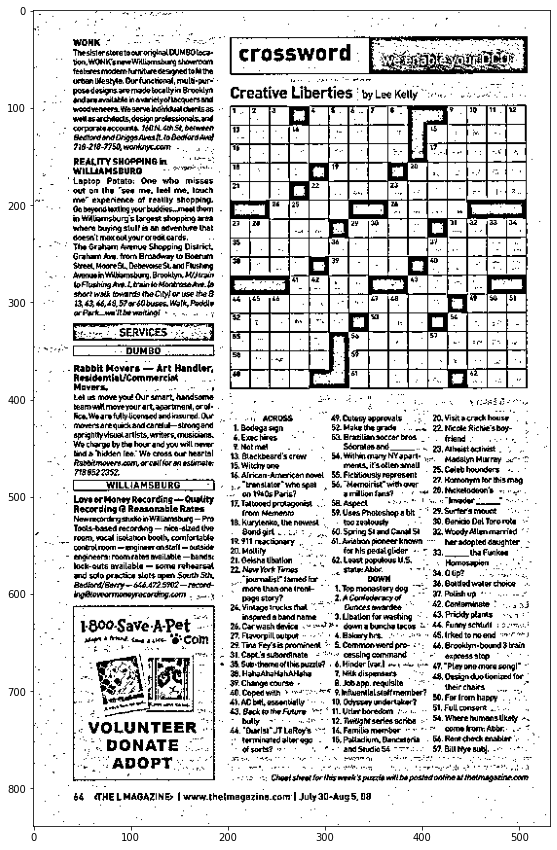

In [ ]:
th2 = cv2.adaptiveThreshold(crossword,255,cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY,11,8)
show_pic(th2)

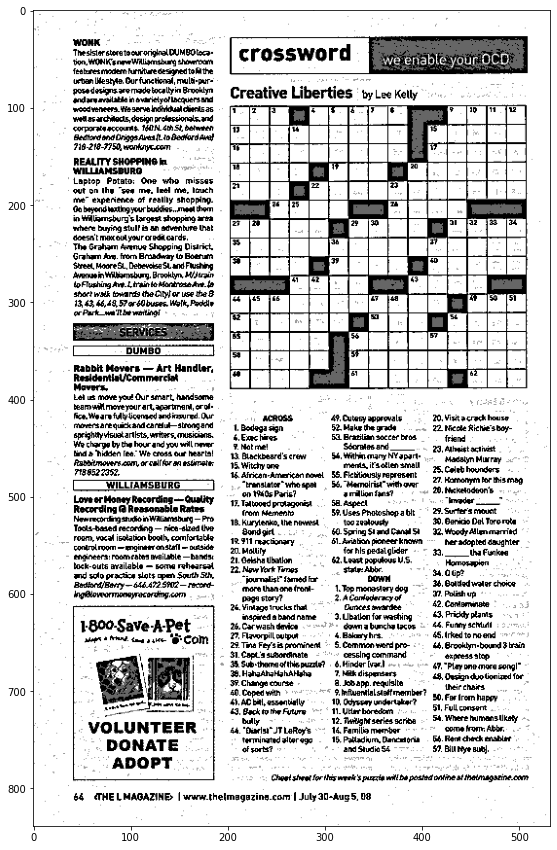

In [ ]:
blended = cv2.addWeighted(src1=th1,alpha=0.6,src2=th2,beta=0.4,gamma=0)
show_pic(blended)

### Bluring and Smoothing:

* A common operation for image processing is blurring or smoothing an image.
* Smoothing an image can help get rid of noise, or help an application focus on general details.
* There are many methods of blurring and smoothing.
* Blurring and smoothing is combined with edge detection.
* Edge detection algorithms detect too many edges when shown a high resolution image without any blurring.

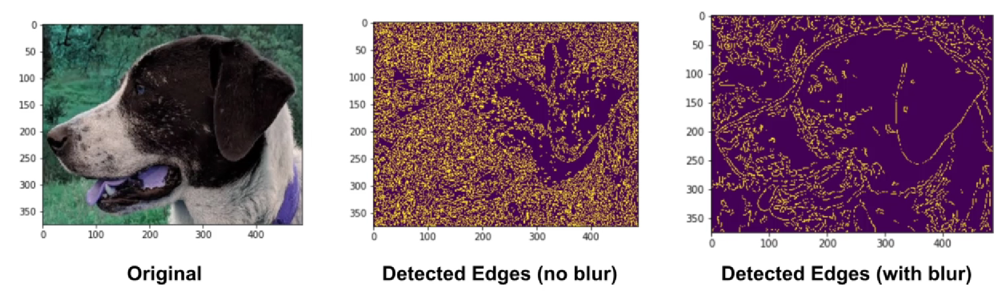

Let's imagine we have a origional image of a dog at the left and we try to detect the edge in that particular image without any blurring, we will get the middle figure. Its too much noisy and has too much details. If we want to detect general edges and shapes, we can just blur the image first and try to smooth it out. Then apply an edge detection algortithms. Methods we'll be exploring are;



#### Gamma Correction: 
Gamma correction can be applied to an image to make it appear brighter or darker depending on the Gamma value chosen.

#### Kernel Based Filters
Kernels can be applied over an image to produce a variety of effects.
The best way to explain this is through an interactive visualization. Go to : http://setosa.io/ev/image-kernels/

#### Bluring and Smoothing with OpenCV:

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

In [ ]:
def load_img():
  img = cv2.imread('/content/bricks.jpg').astype(np.float32)/255
  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
  return img

In [ ]:
def display_img(img):
  fig = plt.figure(figsize=(12,10))
  ax = fig.add_subplot(111)
  ax.imshow(img)

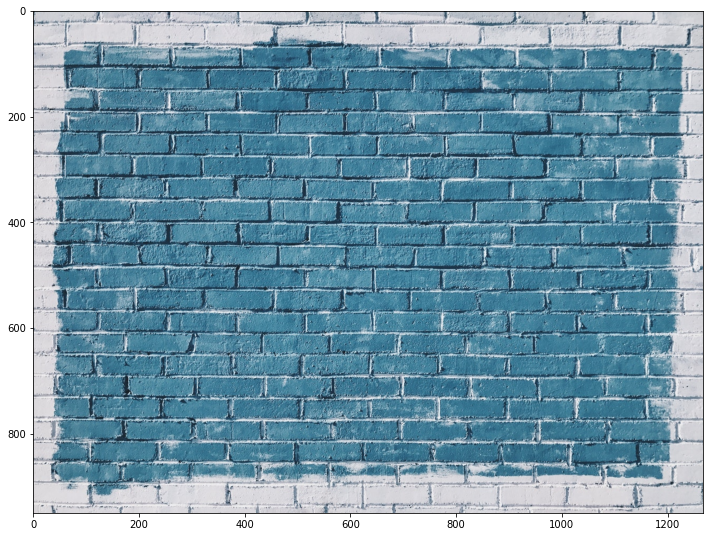

In [ ]:
i = load_img()
display_img(i)

First we load the image and use gamma correction for image bluring and smoothing. For this we choose the gamma value between 0 to 1.

In [ ]:
gamma = 1/4

Now we take every pixel vlue in the image and raise to the power 
of gamma.

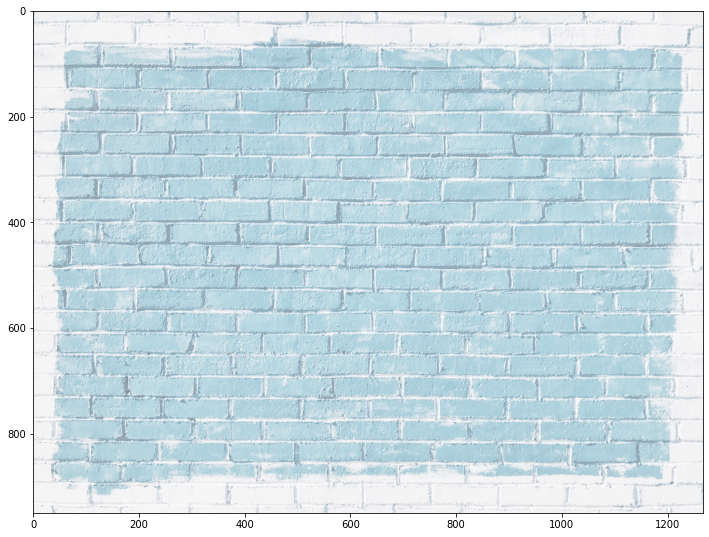

In [ ]:
result = np.power(i,gamma)
display_img(result)

Now we can see image appears to be bighter because we choose gamma less than 1. we observe the imge putting gamma greater than 1, the image appear more darker.



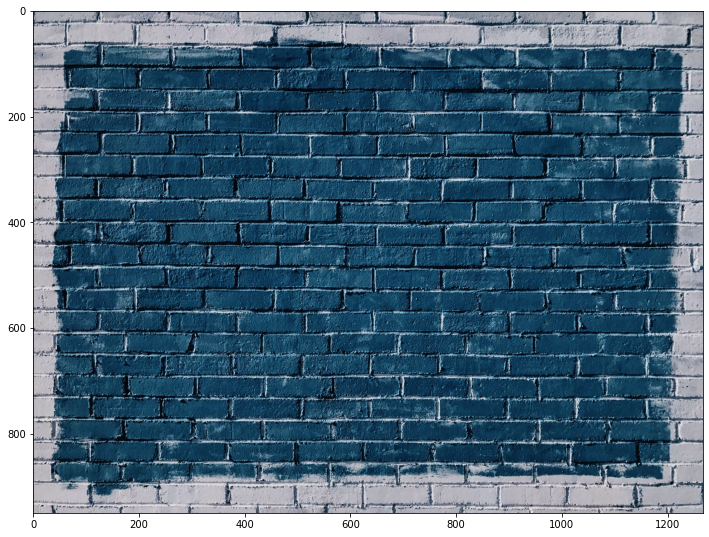

In [ ]:
gamma = 2
image = np.power(i,gamma)
display_img(image)

Choosing really very high value of gamma image appear more darker.

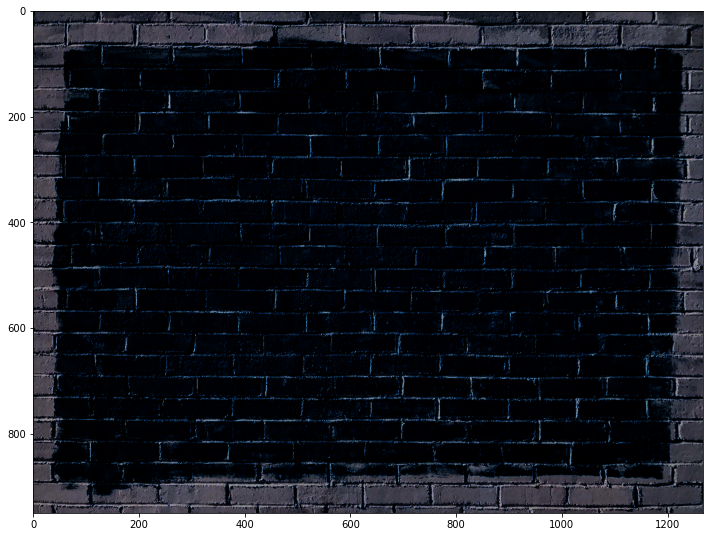

In [ ]:

gamma = 8
image1 = np.power(i,gamma)
display_img(image1)

Here, we write some text on image to see the difference in couple of blured image.

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


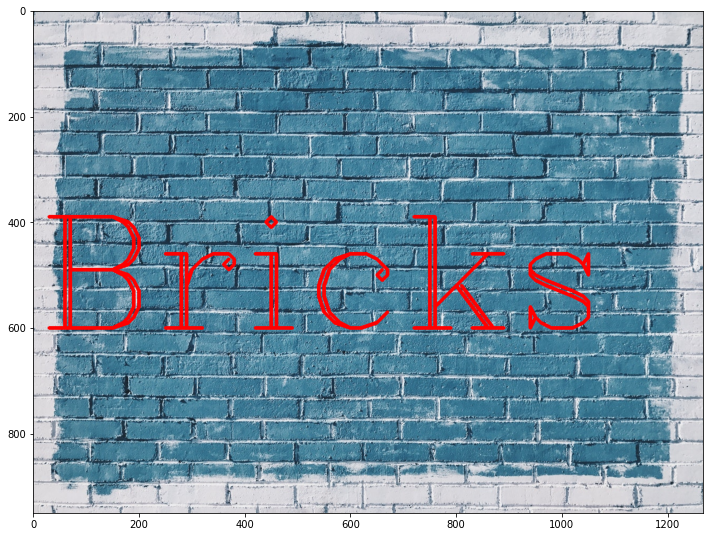

In [ ]:
img = load_img()
font = cv2.FONT_HERSHEY_COMPLEX
cv2.putText(img,text = 'Bricks', org = (10,600),fontFace = font, fontScale = 10, color =(255,0,0),thickness = 5 )
display_img (img)

Setting our kernal for low pass filter. 

In [ ]:
kernel = np.ones(shape=(5,5),dtype=np.float32)/25

In [ ]:
kernel

array([[0.04, 0.04, 0.04, 0.04, 0.04],
       [0.04, 0.04, 0.04, 0.04, 0.04],
       [0.04, 0.04, 0.04, 0.04, 0.04],
       [0.04, 0.04, 0.04, 0.04, 0.04],
       [0.04, 0.04, 0.04, 0.04, 0.04]], dtype=float32)

Applying 2D filter in kernel. 

syntax: cv2.filter2D(image, desired depth, kernel)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


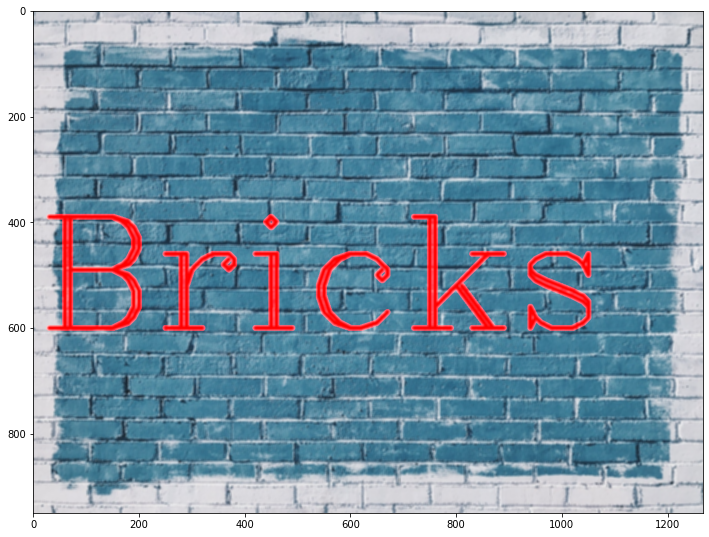

In [ ]:
dst = cv2.filter2D(img,-1,kernel)
display_img(dst)

In [ ]:
img = load_img()
font = cv2.FONT_HERSHEY_COMPLEX
cv2.putText(img, text='Bricks',org=(10,600),fontFace=font,fontScale=10,color=(255,0,0),thickness=4)
print('reset')

reset


Default Bluring kernel:

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


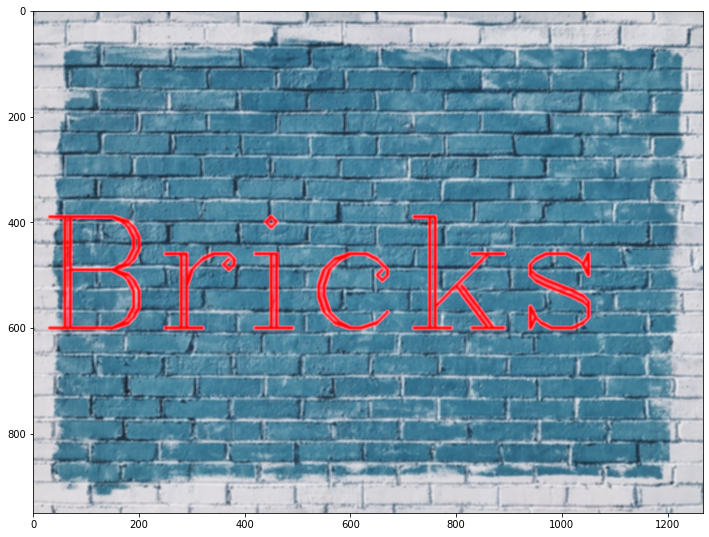

In [ ]:
blured = cv2.blur(img,ksize=(5,5))
display_img(blured)

There are others bluring like Gaussian Bluring and Median Bluring, which just takes a group of pixels and go along and calculates the averages and makes those the outputs.

In [ ]:
img = load_img()
font = cv2.FONT_HERSHEY_COMPLEX
cv2.putText(img, text='Bricks',org=(10,600),fontFace=font,fontScale=10,color=(255,0,0),thickness=4)
print('reset')

reset


Gausian Bluring 

syntax: cv2.GaussianBlur( image, kernel_size, Sigma_value)

sigma_value => Gaussian kernel standard deviation in (x,y)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


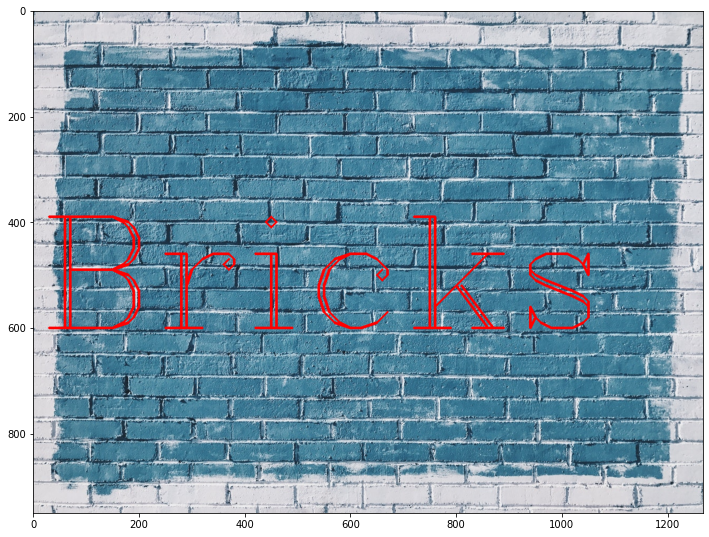

In [ ]:
cv2.GaussianBlur(img,(5,5),10)
display_img(img)

Median Blur: 
**Syntax:** cv2.medianBlur(image,kernel_size)

Kernel: square kernel so takes one argument.

In [ ]:
img = load_img()
font = cv2.FONT_HERSHEY_COMPLEX
cv2.putText(img, text='Bricks',org=(10,600),fontFace=font,fontScale=10,color=(255,0,0),thickness=4)
print('reset')

reset


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


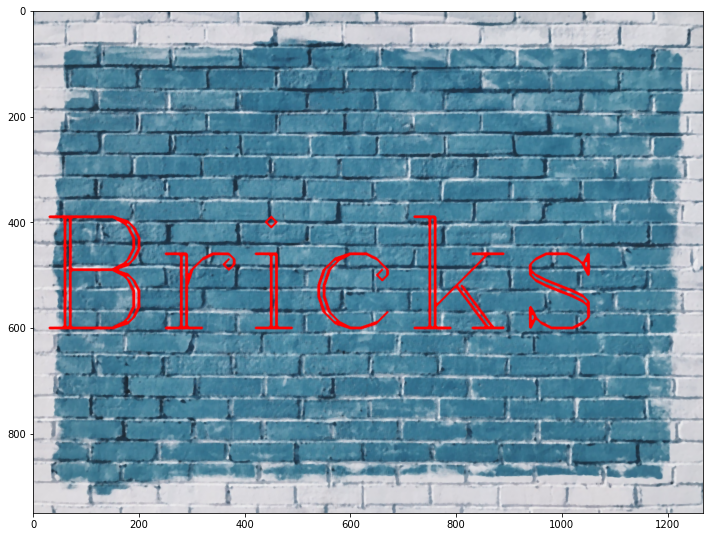

In [ ]:
median = cv2.medianBlur(img,5)
display_img(median)

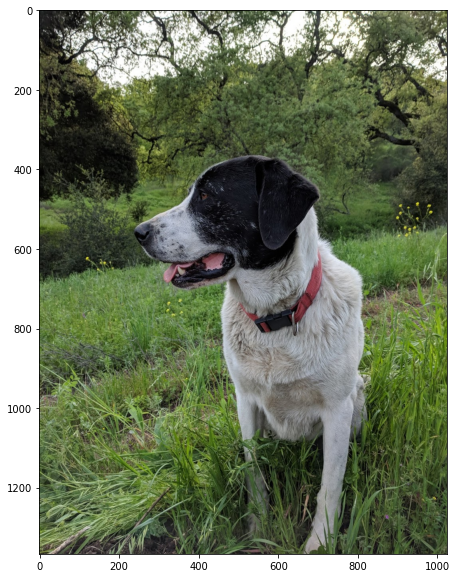

In [ ]:
image = cv2.imread('/content/sammy.jpg')
image = cv2.cvtColor(image,cv2.COLOR_BGR2RGB)
display_img(image)

Adding nosisy image.

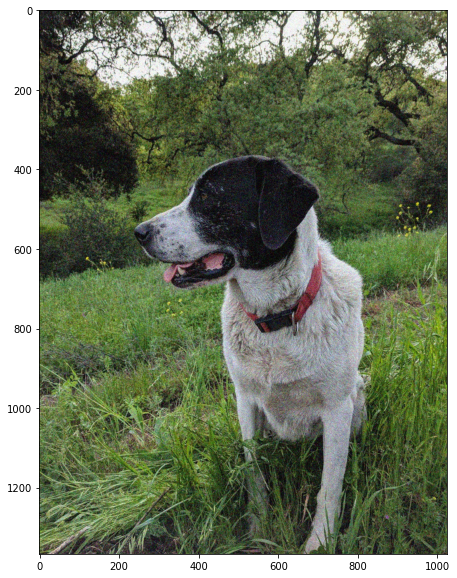

In [ ]:
noise_img = cv2.imread('/content/sammy_noise.jpg')
display_img(noise_img)

Here, we use mediam blur to fix this image.

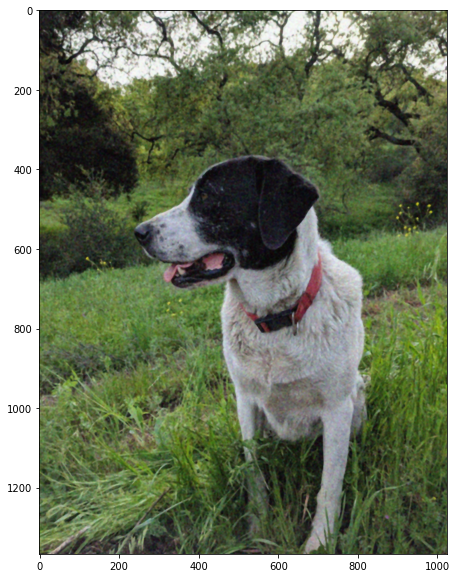

In [ ]:
blured_img = cv2.medianBlur(noise_img,5)
display_img(blured_img)

Bilateral Filtering: Another way of bluring image. For Working mehanism of Bilateral Filtering [Click here.](http://www.dai.ed.ac.uk/CVonline/LOCAL_COPIES/MANDUCHI1/Bilateral_Filtering.html)

It reduce unwanted noise and keep edges fairly sharp.

**Syntax:** cv2.bilateralFilter(image,

In [ ]:
img = load_img()
font = cv2.FONT_HERSHEY_COMPLEX
cv2.putText(img, text='Bricks',org=(10,600),fontFace=font,fontScale=10,color=(255,0,0),thickness=4)
print('reset')

reset


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


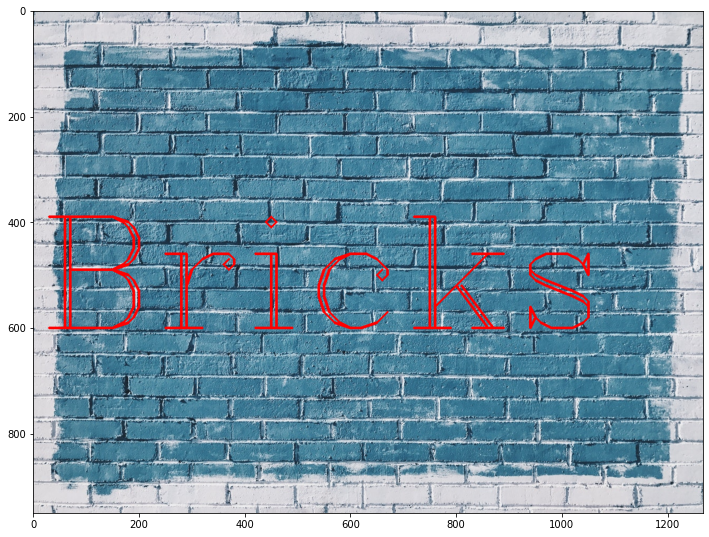

In [ ]:
display_img(img)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


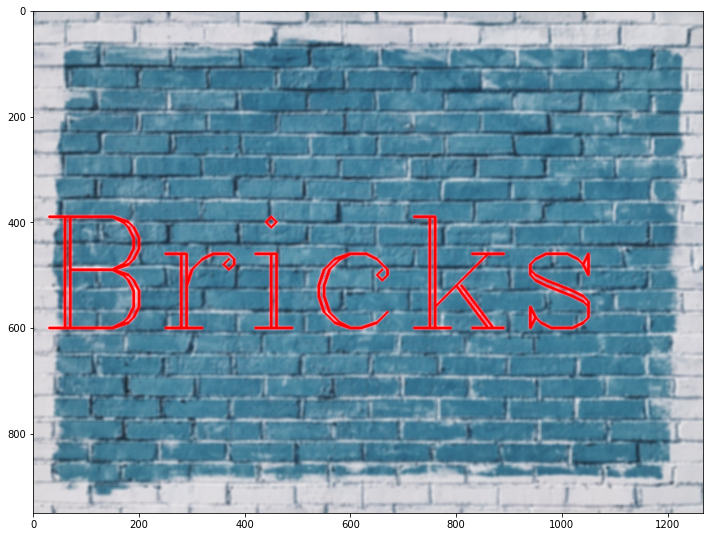

In [ ]:
blur = cv2.bilateralFilter(img,9,75,75)
display_img(blur)

### Morphological Operators:

* Morphological Operators are sets of kernels that can achieve a variety of effects, such as reducing noise.
* Certain operators are very good at reducing black points on a white background
(and vice versa).
* Certain operators can also achieve an erosion and dilation effect that can add or erode from an existing image.
* This effect is mostly easily seen on text data, so we wil practice various morphological operators on same simple white text on a black background.

#### Loading image using function.

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

In [ ]:
def load_img():
  blank_img = np.zeros((600,600))
  font = cv2.FONT_HERSHEY_SIMPLEX
  cv2.putText(blank_img,text='ABCDE',org=(50,300),fontFace=font,fontScale=5,color=(255,255,255),thickness=10)
  return blank_img

In [ ]:
def display_img(img):
  fig = plt.figure(figsize=(12,10))
  ax = fig.add_subplot(111)
  ax.imshow(img,cmap='gray')

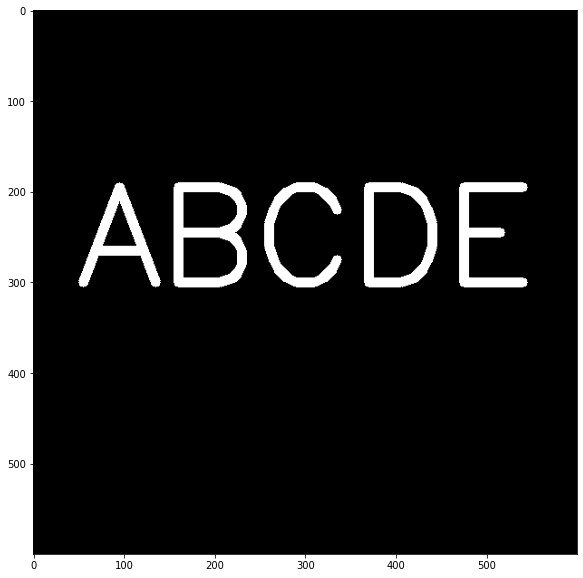

In [ ]:
img = load_img()
display_img(img)


Applying couple of morphologicl operators.

#### Erosion 

Erosion as a morphological operators, essentially eroses over boundary of forground objects. Here in the above figure, the letter look to be in the forground and the black is the general background. Will this kernel detects this edges between our forground text and bacground of black.

In [ ]:
kernel = np.ones((5,5), dtype = np.uint(8))
kernel

array([[1, 1, 1, 1, 1],
       [1, 1, 1, 1, 1],
       [1, 1, 1, 1, 1],
       [1, 1, 1, 1, 1],
       [1, 1, 1, 1, 1]], dtype=uint64)

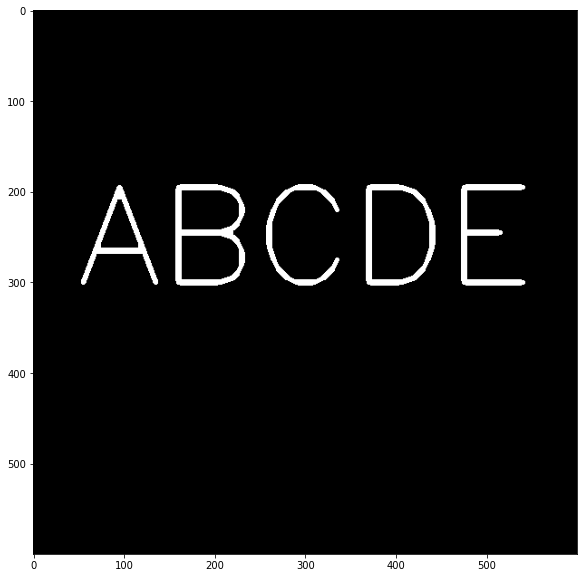

In [ ]:
result = cv2.erode(img,kernel,iterations=1)  # Here iterations means how many passes you want to do.
display_img(result)

#### Dilation

Then the next effect we gonna learning is opening Erosion following by Dilation. Dialation is adding more to that forground, helping to reduce background noice. Let's create the some white noise and add it into origional image.

In [ ]:
img = load_img()
white_noise = np.random.randint(low=0, high=2,size=(600,600))
white_noise

array([[1, 1, 1, ..., 1, 1, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 1, 1, ..., 0, 1, 1],
       ...,
       [0, 1, 1, ..., 1, 0, 1],
       [1, 1, 1, ..., 0, 0, 0],
       [1, 1, 1, ..., 1, 1, 0]])

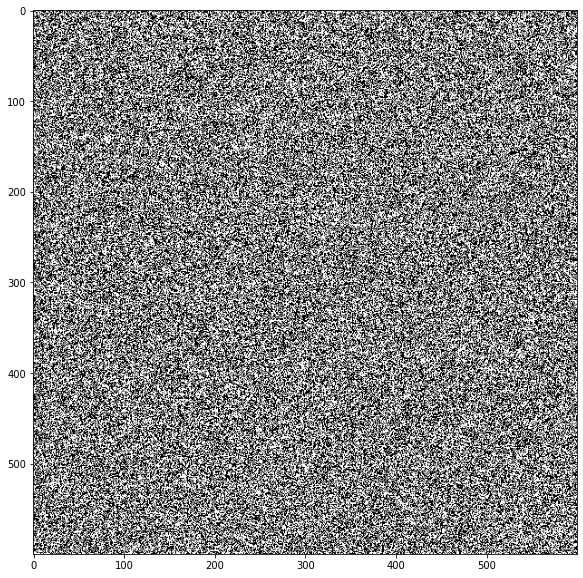

In [ ]:
display_img(white_noise)

Putting this white noice into our origional image.

In [ ]:
img

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

In [ ]:
# checking max value
img.max()

255.0

In [ ]:
# Convert it to 255.
white_noise = white_noise * 255
white_noise

array([[255, 255, 255, ..., 255, 255,   0],
       [  0,   0,   0, ...,   0,   0,   0],
       [  0, 255, 255, ...,   0, 255, 255],
       ...,
       [  0, 255, 255, ..., 255,   0, 255],
       [255, 255, 255, ...,   0,   0,   0],
       [255, 255, 255, ..., 255, 255,   0]])

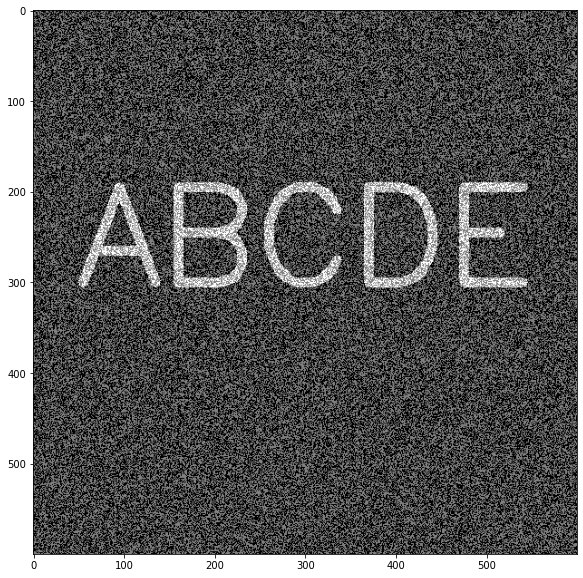

In [ ]:
noise_img = white_noise + img
display_img(noise_img)

This is our noise image, Now we use opening as a morphological operator to actually raid of this noise.

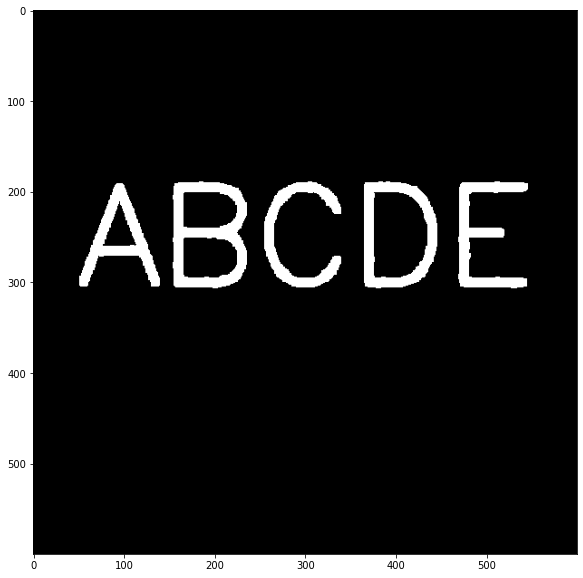

In [ ]:
opening = cv2.morphologyEx(noise_img, cv2.MORPH_OPEN,kernel)
display_img(opening)

We notice, Opening is essentially able to clear out lot of the noise without too much distortion of the origional text image.

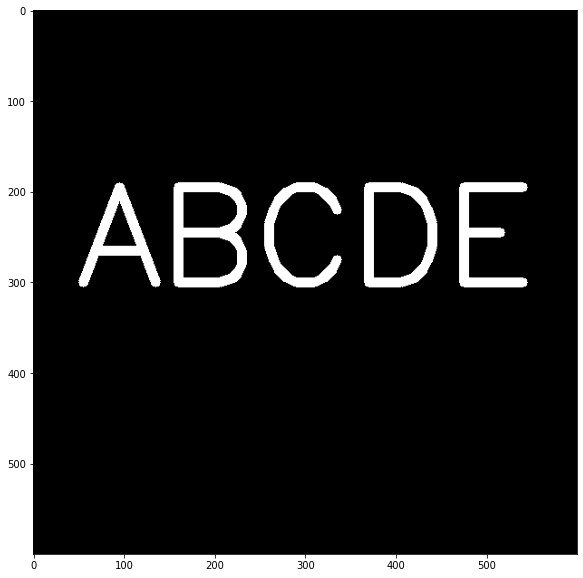

In [ ]:
display_img(img)

Now, we create a image that has forground  noise.

In [ ]:
img = load_img()

In [ ]:
black_noise = np.random.randint(low=0,high=2, size=(600,600))
black_noise

array([[1, 1, 1, ..., 0, 0, 0],
       [1, 1, 1, ..., 1, 1, 0],
       [1, 0, 0, ..., 0, 1, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 1],
       [0, 0, 1, ..., 0, 0, 0],
       [1, 1, 1, ..., 1, 0, 0]])

In [ ]:
black_noise = black_noise * -255
black_noise

array([[-255, -255, -255, ...,    0,    0,    0],
       [-255, -255, -255, ..., -255, -255,    0],
       [-255,    0,    0, ...,    0, -255,    0],
       ...,
       [   0,    0,    0, ...,    0,    0, -255],
       [   0,    0, -255, ...,    0,    0,    0],
       [-255, -255, -255, ..., -255,    0,    0]])

In [ ]:
black_noise_img = img + black_noise
black_noise_img[black_noise_img == -255] = 0
black_noise_img.min()


0.0

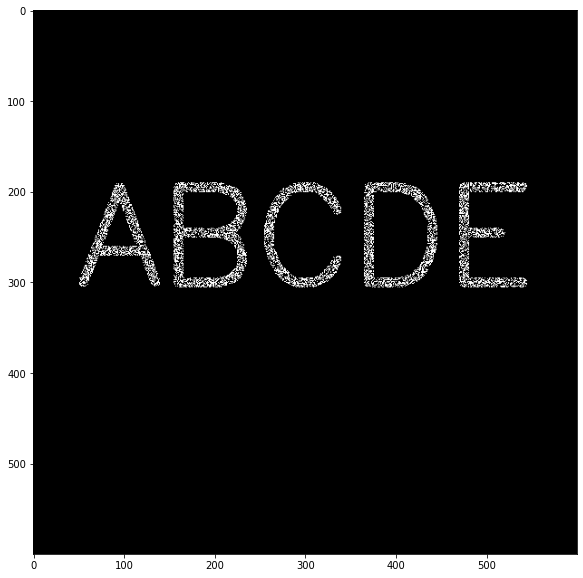

In [ ]:
display_img(black_noise_img)

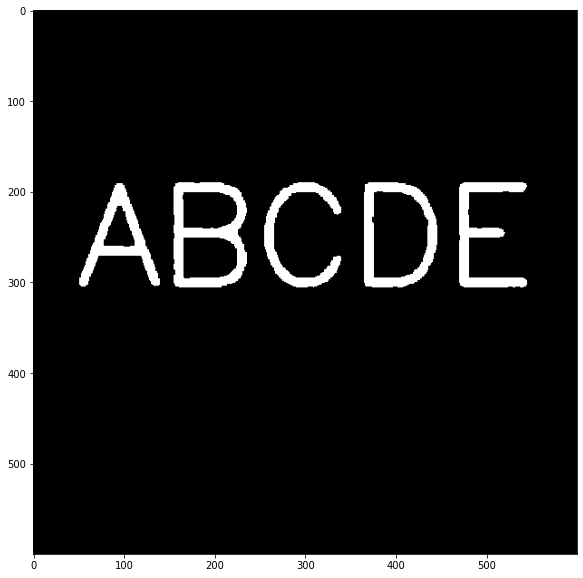

In [ ]:
closing = cv2.morphologyEx(black_noise_img, cv2.MORPH_CLOSE, kernel)
display_img(closing)

### Gradient

Morphological gradient just takes the difference between the dilation and Erosian of an image. 

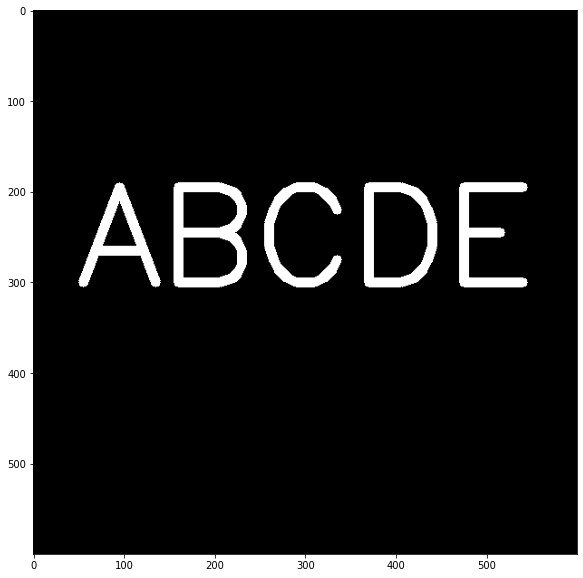

In [ ]:
img = load_img()
display_img(img)

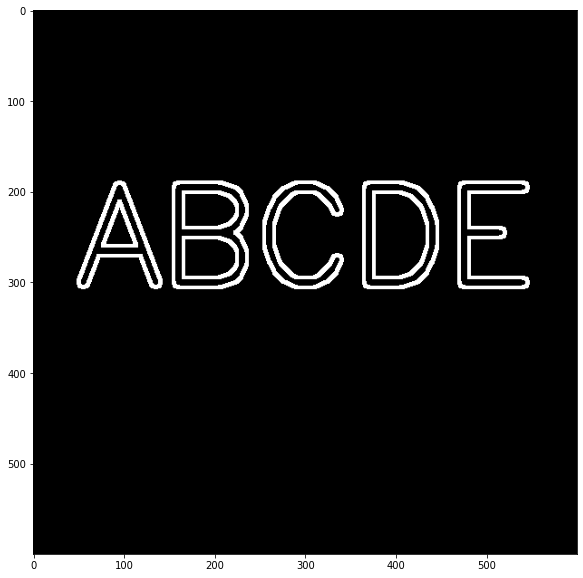

In [ ]:
gradient = cv2.morphologyEx(img, cv2.MORPH_GRADIENT, kernel)
display_img(gradient)


* An image gradient is a directional change in the intensity or color in an image.
* Here, we explore basic Sobel-Feldman Operators (often called Sobel for short)
* Later on in this chapter we will expand on this operator for general edge detection.

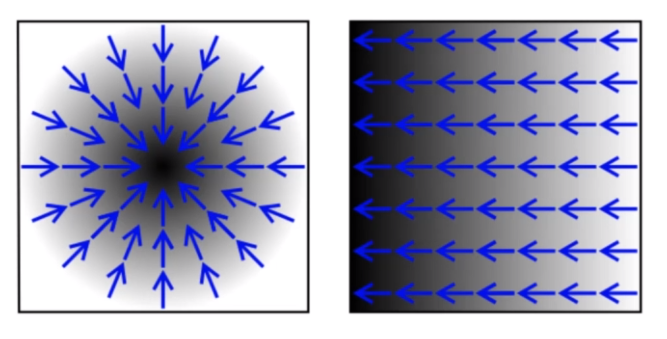

Gradient can be calcualted in the specific direction. Here we see the picture of the cat x directional gradient calcualted.

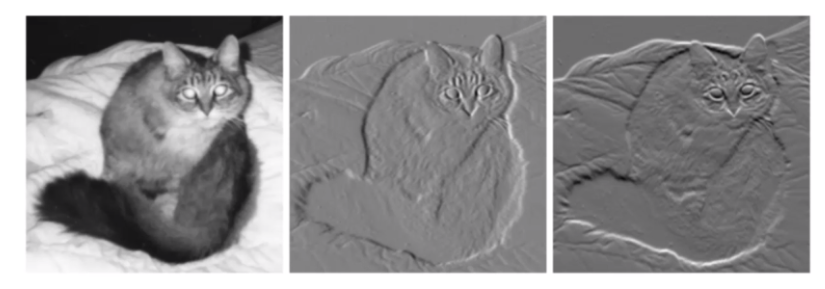

Here we see the image of a bike, Let's calculate some gradients. 

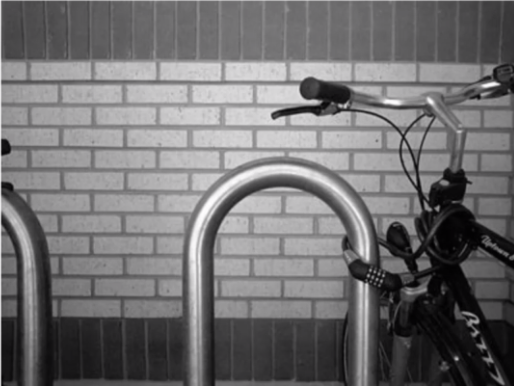

If we calcualted the normalized x-gradient from Sobel-Feldman Operator. Notice that we only see vertical edges of the bricks

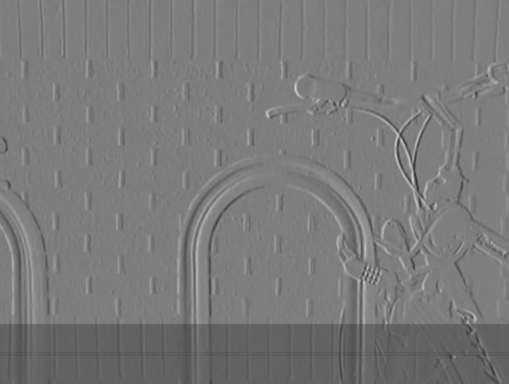

Here, we are applying Normalized x-gradient, so that we can notice only vertical edges of bricks. If we apply Normallized y-gradient, then we actually see horizontal edges. There in the below images we call clearly see horizontal edges.

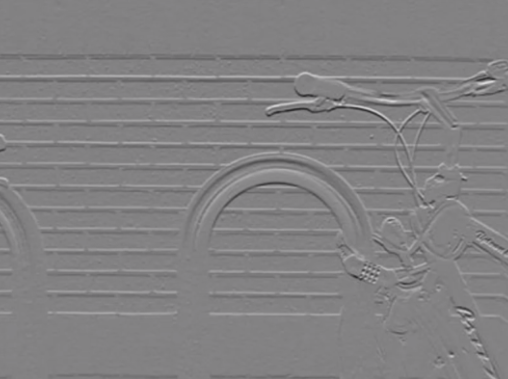

We can also Normalized gradient magnitude from Sobel-Feldman operator. Here we can see both vertical and horizontal edges.

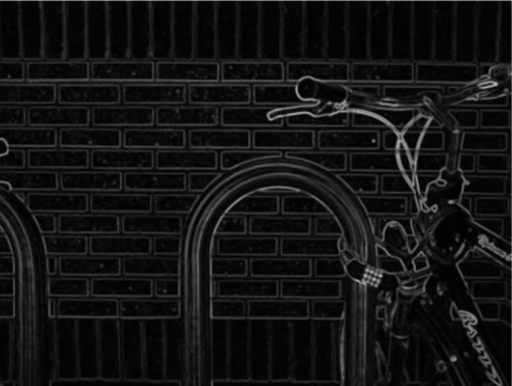

The operator uses tow 3x3 kernels which are convolved with the origional image to calculate approximations of the derivatives.
One for horizontal changes, and one for vertical.

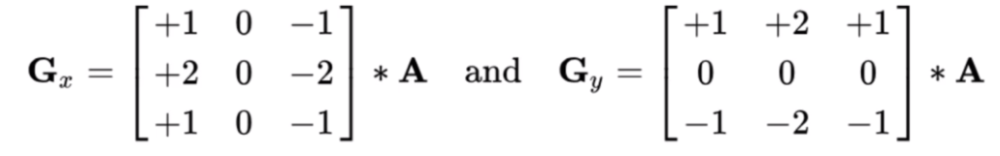

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

In [ ]:
def display_img(img):
  fig = plt.figure(figsize=(12,10))
  ax = fig.add_subplot(111)
  ax.imshow(img,cmap='gray')

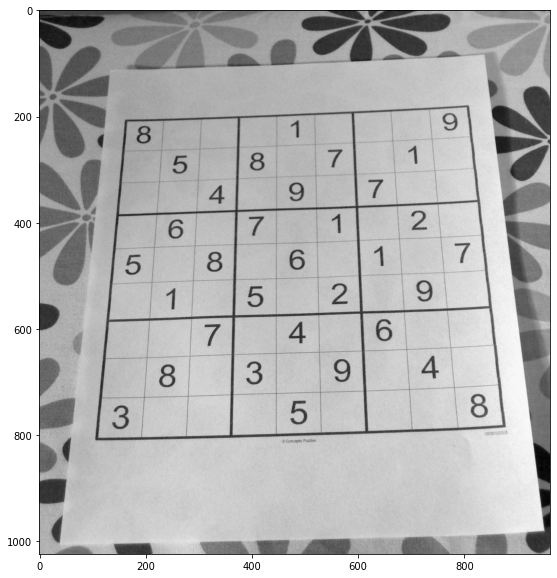

In [ ]:
img = cv2.imread('/content/sudoku.jpg',0)
display_img(img)

First calculating x-gradient. Here we use x gradient, we see the vertical lines and the vertical line is cleared.

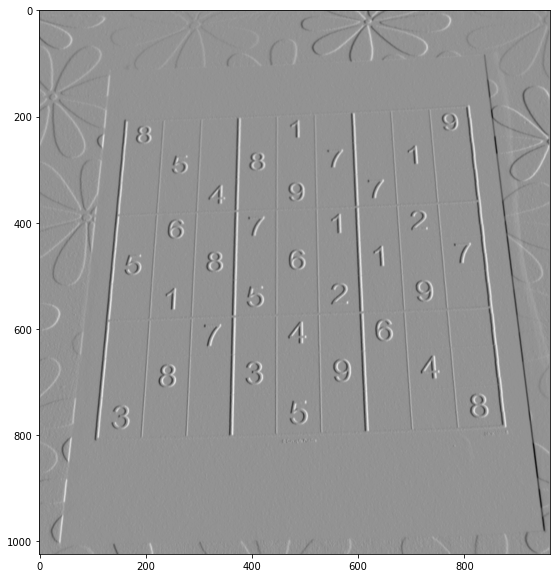

In [ ]:
sobelx = cv2.Sobel(img,cv2.CV_64F,1,0, ksize=5)
display_img(sobelx)

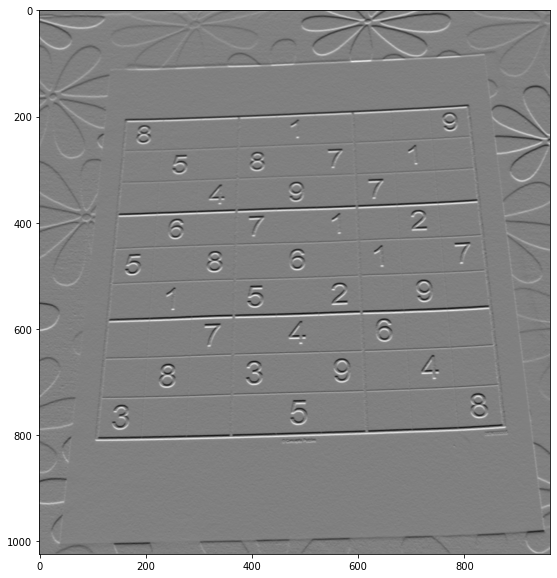

In [ ]:
# For vertical gradient.
sobely = cv2.Sobel(img,cv2.CV_64F,0,1, ksize=5)
display_img(sobely)

There is one more gradient type, thats using Laplacian Derivative. It's just calculate laplacian of the image.

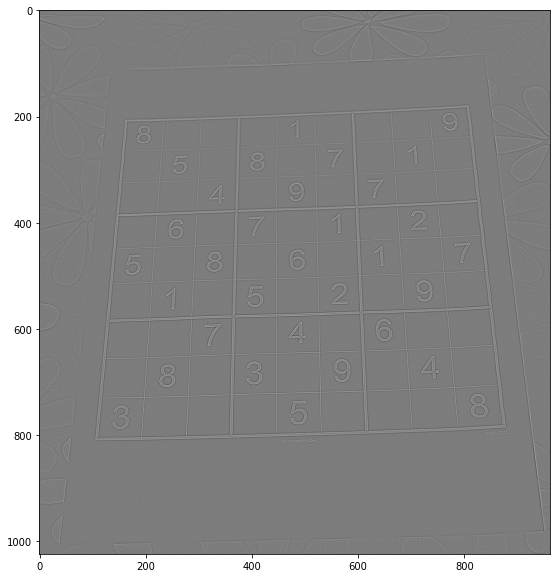

In [ ]:
laplacian = cv2.Laplacian(img,cv2.CV_64F)
display_img(laplacian)

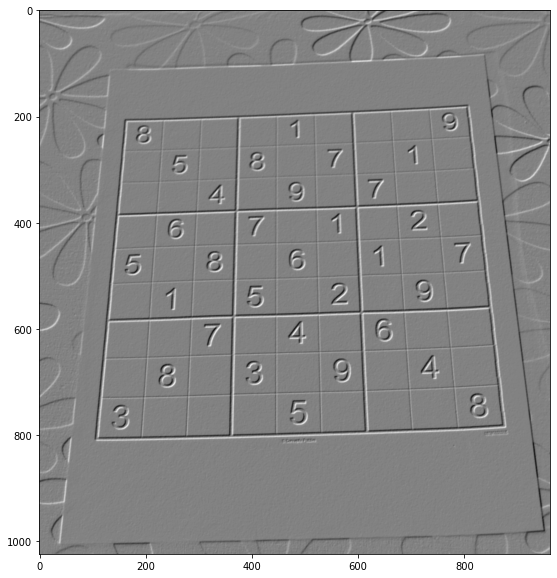

In [ ]:
blended = cv2.addWeighted(src1=sobelx,alpha=0.5, src2=sobely, beta=0.5, gamma=0)
display_img(blended)

Providing threshold to this image.

In [ ]:
ret, th1 = cv2.threshold(img,100,255, cv2.THRESH_BINARY)
display_img

<function __main__.display_img>

In [ ]:
kernel = np.ones((4,4),np.uint8)

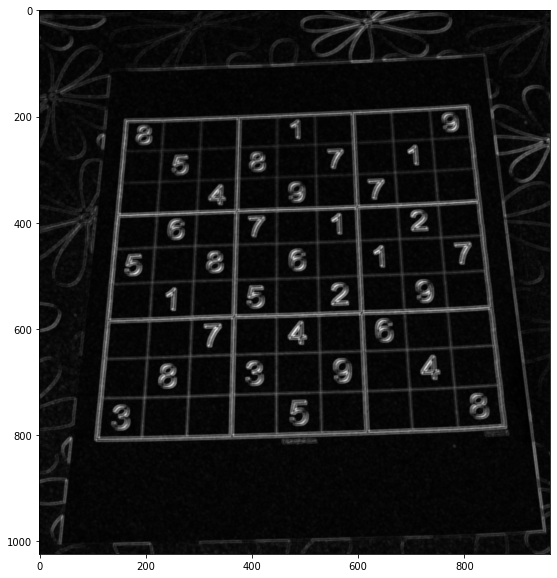

In [ ]:
gradient = cv2.morphologyEx(blended,cv2.MORPH_GRADIENT,kernel)
display_img(gradient)

### Image Histogram:

A histogram is a visual representation of the distribution of a continous feature.
* For images, we can display the frequency of the value for colors.
* Each of the three RGB channels has values between 0-255.
* We can plot these as 3 histograms on top of each other to see how much of each channels there is .

Here, is the histogram of the blue bricks images. Here we see the lower value of red , and we have higher value of green and blue.

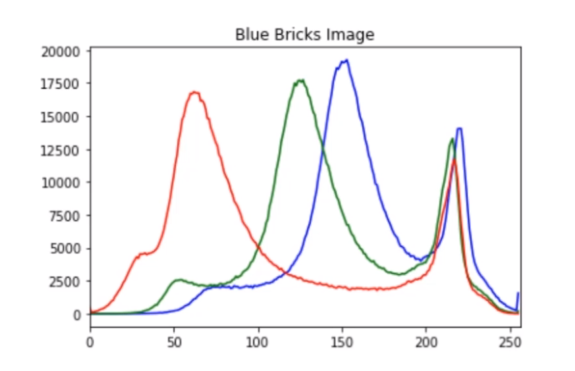

Let's create image histograms with matplotlib and OpenCV.

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

In [ ]:
# Importing 3 images.
dark_horse = cv2.imread('/content/horse.jpg') # Origional BGR opencv.
show_horse = cv2.cvtColor(dark_horse, cv2.COLOR_BGR2RGB)

rainbow = cv2.imread('/content/rainbow.jpg')
show_rainbow = cv2.cvtColor(rainbow, cv2.COLOR_BGR2RGB)

blue_bricks = cv2.imread('/content/rainbow.jpg')
show_bricks = cv2.cvtColor(blue_bricks, cv2.COLOR_BGR2RGB)

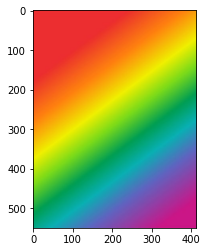

In [ ]:
plt.imshow(show_rainbow);

Calcualting the Histogram value:

In [ ]:
hist_values = cv2.calcHist([blue_bricks], channels=[0], mask=None, histSize=[256], ranges=[0,256]) # In BGR channel 

In [ ]:
# checking hist size
hist_values.shape

(256, 1)

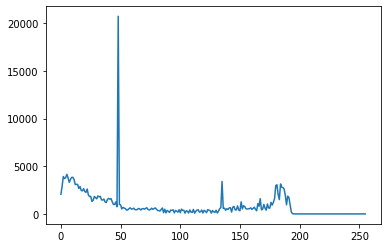

In [ ]:
plt.plot(hist_values);

Calcualting histogram for horse:

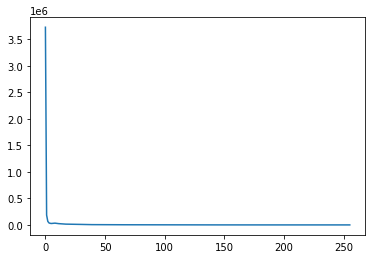

In [ ]:
hist_horse = cv2.calcHist([dark_horse], channels=[0], mask=None, histSize=[256], ranges=[0,256])
plt.plot(hist_horse)

Here, we see most of the values for the blue channels are pretty much zero which makes sense because most of the image is black, which is zero and the horse is redish brown.

#####  Plotting three colors histograms in the bricks image.

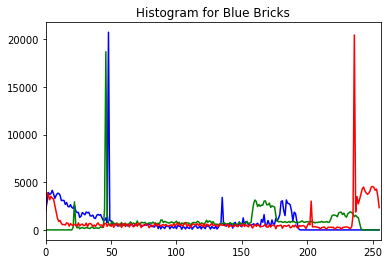

In [ ]:
img = blue_bricks
color = ('b', 'g', 'r')

for i, col in enumerate (color):
  histr = cv2.calcHist([img],[i], None, [256],[0,256])
  plt.plot(histr, color=col)
  plt.xlim([0,256])
plt.title('Histogram for Blue Bricks');


Plotting three colors histograms in the horse image.

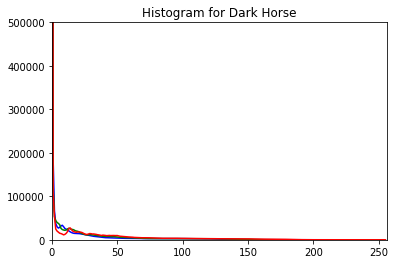

In [ ]:
horse = dark_horse
color = ('b', 'g', 'r')

for i, col in enumerate (color):
  histr = cv2.calcHist([horse],[i], None, [256],[0,256])
  plt.plot(histr, color=col)
  plt.xlim([0,256])
  plt.ylim([0,500000])
  
plt.title('Histogram for Dark Horse');

##### Histogram on  a masked portion of the Image:

We can select an ROI and only calculate the color histogram of that masked section. Let's see how to create a masked and achieve this effect.

##### Histogram Equalization: 

Histogram Equalization is the method of constat adjustment based on the image's histogram.

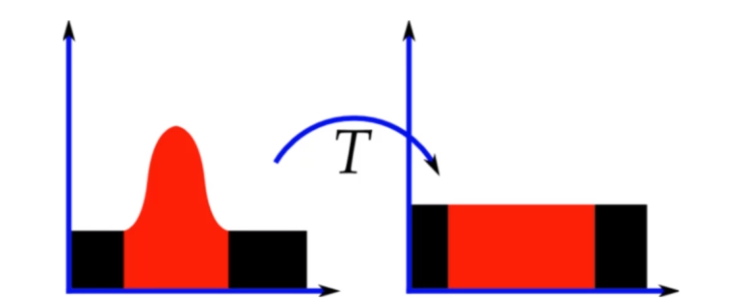

**Example of an origional image:**
On the left we have the actual color values and in the middle we have small image, then we see the origional color histogram. 

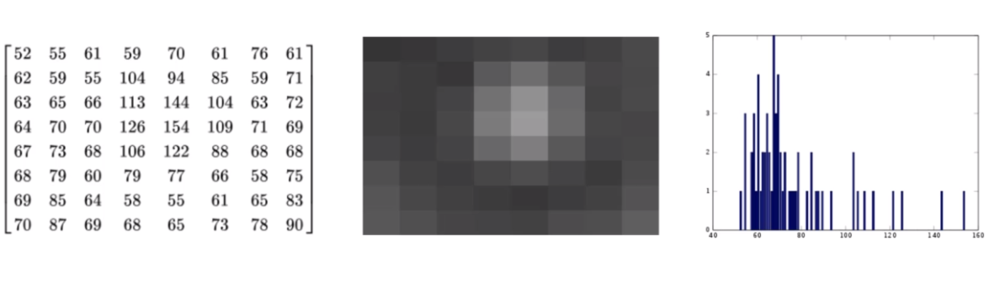

Here, we apply the histogram equaliztion which will reduce the color depth (shades of gray). So, let's take a look at the origional min and max values. (max:154, min:52)

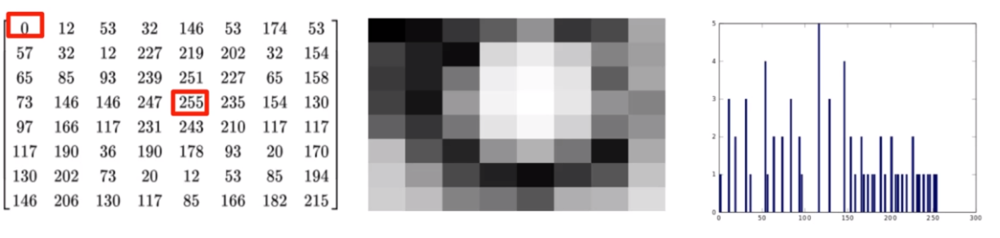

After apply histogram  equalization, left min value transform to 0 and max value: 254 transform to 255.

Let's see what happens to the image itself, circle in the middle is clearly white and we have clear border of edge. Histogram is also more flatten now.


**Key:**
* Notice how the min and max values have now been equalized to be 0 and 255.
* We also now see less shades of gray (resulting in higher constrast)


**Let's now see the results on  a normal image:** So here on the left handside, we have image of some hills and on the right we have the actual histogram for those gray scale values.

Here, the red represent the histogram for the grayscale values and the black lines represents the cumulative histogram there.

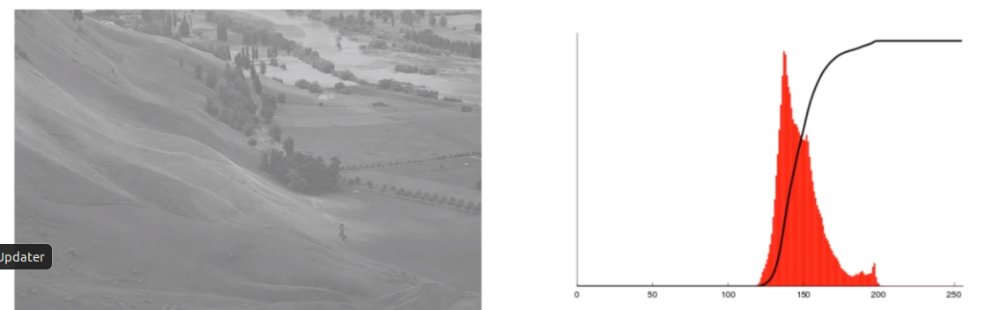

If we apply histogram equalization, what happens is the cumulative then becomes linear steps functions and we get much higher constract on the actual image.

**Note:** We cannot make the histogram perfectly flat.

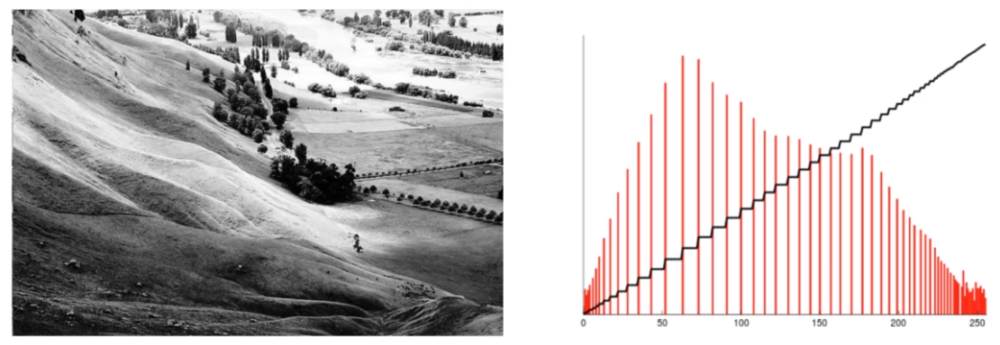

Now, Let's try coding this.

In [ ]:
rainbow = cv2.imread('/content/rainbow.jpg')
show_rainbow = cv2.cvtColor(rainbow, cv2.COLOR_BGR2RGB)

In [ ]:
img = rainbow
img.shape

(550, 413, 3)

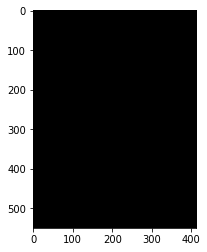

In [ ]:
# Now, creating mask
mask = np.zeros(img.shape[:2], np.uint8)
plt.imshow(mask, cmap='gray');

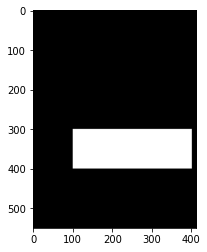

In [ ]:
mask[300:400,100:400]= 255 # set white
plt.imshow(mask,cmap= 'gray')

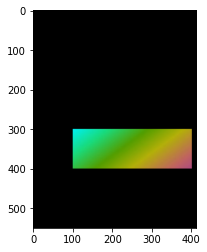

In [ ]:
masked_img = cv2.bitwise_and(img, img, mask=mask)
plt.imshow(masked_img)

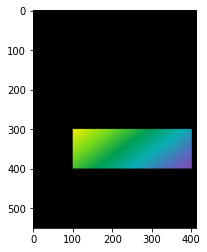

In [ ]:
show_masked_img = cv2.bitwise_and(show_rainbow,show_rainbow,mask=mask)
plt.imshow(show_masked_img);

Text(0.5, 1.0, 'Red Histogram for masked Rainbow')

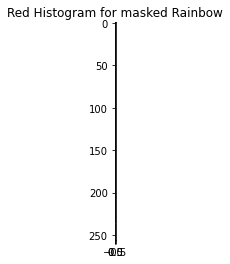

In [ ]:
hist_value_red = cv2.calcHist([rainbow], channels=[2], mask=None, histSize=[256], ranges=[0,256])
plt.imshow(hist_value_red)
plt.title('Red Histogram for masked Rainbow')

In [ ]:
hist_mask_value_red = cv2.calcHist([], channels=[2], mask=mask, histSize=[256], ranges=[0,256])
plt.imshow(hist_mask_value_red);


error: ignored